In [1]:
from IPython.display import Image

In [4]:
%cd /content/YOLOv8-DeepSORT-Object-Tracking

/content/YOLOv8-DeepSORT-Object-Tracking


In [5]:
!pip install -e '.[dev]'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/YOLOv8-DeepSORT-Object-Tracking
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.1/154.1 KB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.0/227.0 KB 29.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 89.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 106.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 KB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 KB 19.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 90.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

##Moving to the Required Directory

In [6]:
%cd /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


##Importing the Dataset from the RoboFlow

In [7]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="70SpXc1OmTXzM9mxngGh")
project = rf.workspace("drone-dataset-mvh8i").project("detection-bzujh")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 KB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 KB 10.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 7.8 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9674 sha256=7a20a53012ae95785caecbdeb4257ac34fd4fe2bc0ace4a3ea072de91ab4ab8c
  Stored in directory: /root/.cache/pip/wheels/bd/a8/c3/3cf2c14a1837a4e04bd98631724e81f33f462d86a1d895fae0
Successfully built wget
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pypar

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to detection-1 in yolov5pytorch:: 100%|██████████| 9374/9374 [00:02<00:00, 4104.93it/s]


##To implement the DeepSORT tracking, downloading the required files 

In [8]:
!gdown "https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/deep_sort_pytorch.zip
100% 43.1M/43.1M [00:00<00:00, 302MB/s]


##Unzipping the DeepSORT Files

In [9]:
!unzip 'deep_sort_pytorch.zip'

Archive:  deep_sort_pytorch.zip
  inflating: deep_sort_pytorch/.gitignore  
   creating: deep_sort_pytorch/configs/
  inflating: deep_sort_pytorch/configs/deep_sort.yaml  
   creating: deep_sort_pytorch/deep_sort/
  inflating: deep_sort_pytorch/deep_sort/__init__.py  
   creating: deep_sort_pytorch/deep_sort/__pycache__/
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-310.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-37.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-38.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-310.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-37.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-38.pyc  
   creating: deep_sort_pytorch/deep_sort/deep/
 extracting: deep_sort_pytorch/deep_sort/deep/__init__.py  
   creating: deep_sort_pytorch/deep_sort/deep/__pycache__/
  inflating: deep_sort_pytorch/d

#**Training the Custom Model**

In [10]:
HOME = '/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect'

In [11]:
%cd {HOME}

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [12]:
%cd {dataset.location}

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/detection-1


In [ ]:
%cd {HOME}

!python train.py model=yolov8l.pt data={dataset.location}/data.yaml epochs=50 imgsz=640

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect
yolo/engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/detection-1/data.yaml, epochs=50, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=False, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, retina_masks=False, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False,

#**Checking the Files inside the Train Folder**

In [ ]:
!ls /content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train2

args.yaml					    train_batch10161.jpg
confusion_matrix.png				    train_batch10162.jpg
events.out.tfevents.1674382363.63e305c92538.3354.0  train_batch1.jpg
F1_curve.png					    train_batch2.jpg
P_curve.png					    val_batch0_labels.jpg
PR_curve.png					    val_batch0_pred.jpg
predictions.json				    val_batch1_labels.jpg
R_curve.png					    val_batch1_pred.jpg
results.csv					    val_batch2_labels.jpg
results.png					    val_batch2_pred.jpg
train_batch0.jpg				    weights
train_batch10160.jpg


#**Printing the Confusion Matrix**

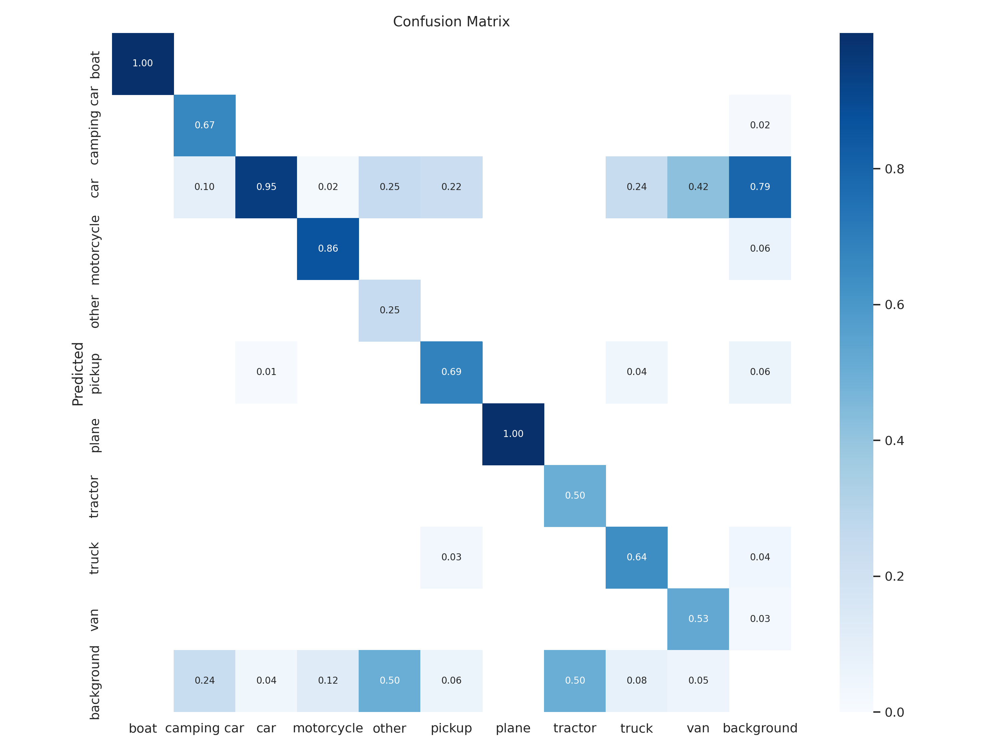

In [ ]:
Image(filename = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train2/confusion_matrix.png')

#**Printing the Training and the Validation Loss**

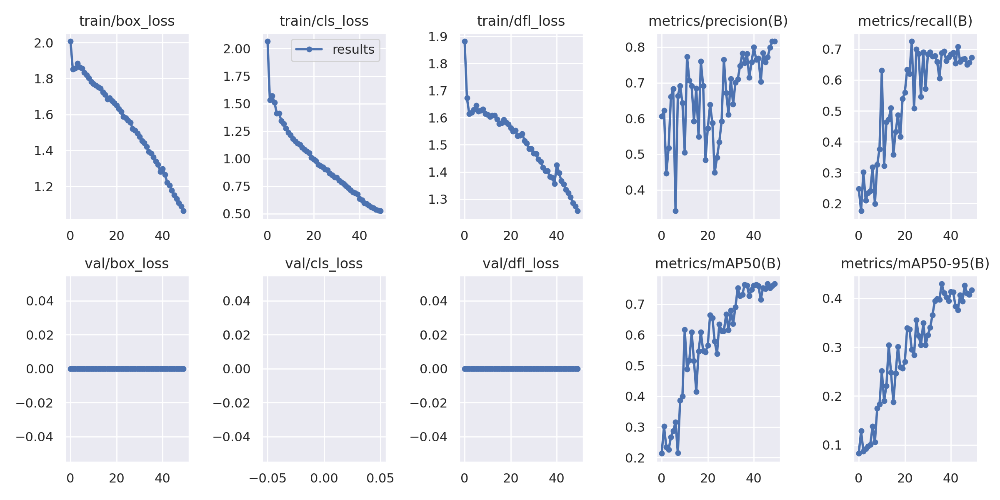

In [ ]:
Image(filename = r'/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train2/results.png', width = 600)

#**Printing the Model Prediction on Validation Batch**

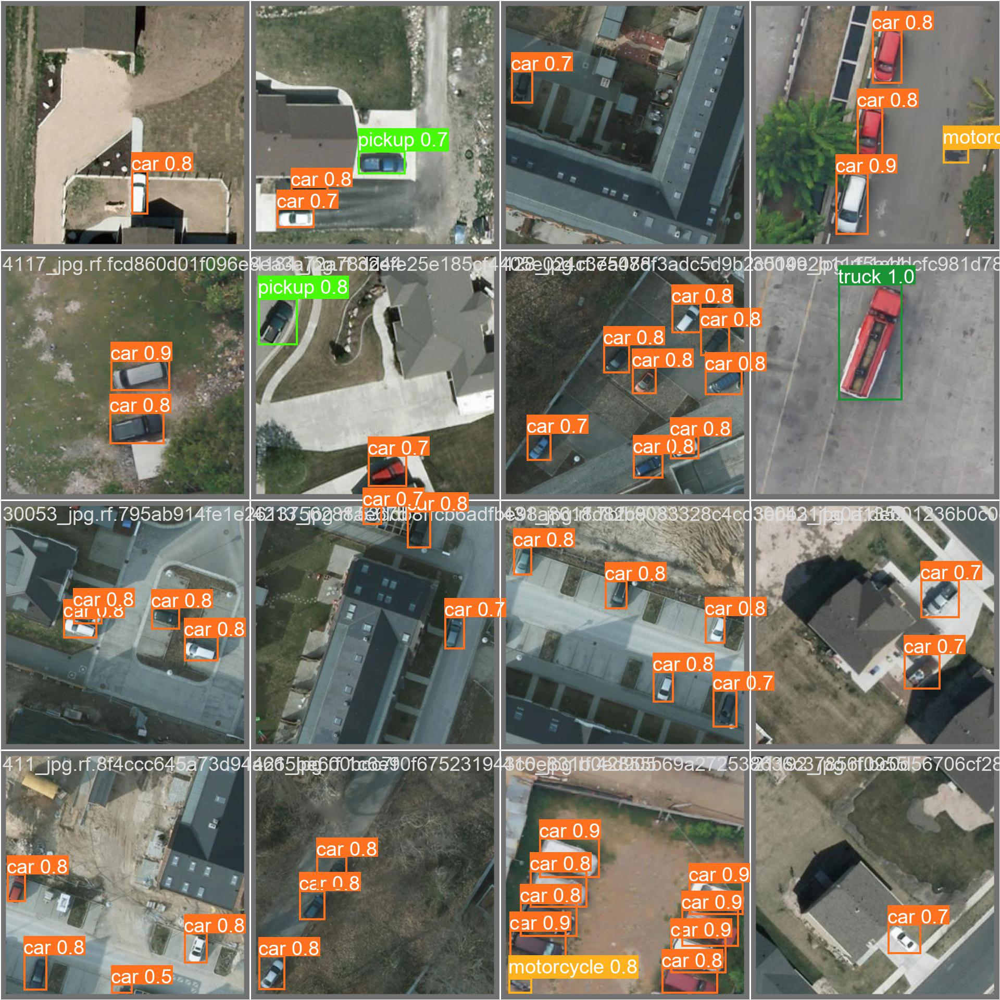

In [ ]:
Image(filename = r'/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train2/val_batch2_pred.jpg', width =600)

#**Downloading the Weights From the Google Drive**"


In [13]:
%cd {HOME}

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [14]:
!gdown "https://drive.google.com/uc?id=1VBAZtJ5uJMEsnyya_d0yMP6efBRQ8IX-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1VBAZtJ5uJMEsnyya_d0yMP6efBRQ8IX-&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/best.pt
100% 87.7M/87.7M [00:00<00:00, 117MB/s] 


#**Validate Custom Model**

In [15]:
!pwd

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [ ]:
!python val.py model='best.pt' data={dataset.location}/data.yaml

Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
Model summary: 268 layers, 43614318 parameters, 0 gradients, 164.9 GFLOPs
val: Scanning /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/detection-1/valid/labels.cache... 619 images, 1 backgrounds, 0 corrupt: 100% 619/619 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 39/39 [00:27<00:00,  1.42it/s]
                   all        619       2185      0.757      0.687      0.764      0.429
                  boat        619          1      0.472          1      0.995      0.796
           camping car        619         21      0.866      0.667      0.735      0.379
                   car        619       1963      0.882      0.918      0.911      0.422
            motorcycle        619         59      0.859      0.678      0.844      0.326
                 other        619          4       0.32       0.25 

#**Inference with Custom Model**

#**Demo Video 1**

In [15]:
!gdown "https://drive.google.com/uc?id=1UUZUS76ylH5RjMSc9s4rITSYDTG5AHt0&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1UUZUS76ylH5RjMSc9s4rITSYDTG5AHt0&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4
100% 7.96M/7.96M [00:00<00:00, 36.9MB/s]


In [16]:
!python predict.py model='best.pt' source='test4.mp4'

[2023-01-22 17:23:27,746][root.tracker][INFO] - Loading weights from deep_sort_pytorch/deep_sort/deep/checkpoint/ckpt.t7... Done!
Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
Model summary: 268 layers, 43614318 parameters, 0 gradients, 164.9 GFLOPs
video 1/1 (1/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 41.5ms
video 1/1 (2/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 40.7ms
video 1/1 (3/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 40.6ms
video 1/1 (4/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 36.2ms
video 1/1 (5/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test4.mp4: 384x640 11 cars, 26.9ms
video 1/1 (6/808) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/t

#**Display the Demo Video**

In [17]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [18]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train/test4.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Demo Video 2**

In [19]:
!gdown "https://drive.google.com/uc?id=1MaH6dNoegFjwkhtedxXufn2UD7EPpF_w&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1MaH6dNoegFjwkhtedxXufn2UD7EPpF_w&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4
100% 3.79M/3.79M [00:00<00:00, 222MB/s]


In [20]:
!python predict.py model='best.pt' source='test2.mp4'

[2023-01-22 17:27:43,594][root.tracker][INFO] - Loading weights from deep_sort_pytorch/deep_sort/deep/checkpoint/ckpt.t7... Done!
Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
Model summary: 268 layers, 43614318 parameters, 0 gradients, 164.9 GFLOPs
video 1/1 (1/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 20 cars, 41.5ms
video 1/1 (2/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 20 cars, 36.7ms
video 1/1 (3/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 18 cars, 36.6ms
video 1/1 (4/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 19 cars, 26.3ms
video 1/1 (5/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/test2.mp4: 384x640 19 cars, 26.3ms
video 1/1 (6/319) /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/t

#**Display the Demo Video**

In [21]:
!rm "/content/result_compressed.mp4"

In [22]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train2/test2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)